In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/NIDHI/

/content/drive/MyDrive/NIDHI


In [ ]:
!nvidia-smi

Fri Dec 29 08:37:31 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content/drive/MyDrive/NIDHI


## Install YOLOv8

⚠️ YOLOv8 is still under heavy development. Breaking changes are being introduced almost weekly. We strive to make our YOLOv8 notebooks work with the latest version of the library. Last tests took place on **27.01.2023** with version **YOLOv8.0.20**.

If you notice that our notebook behaves incorrectly - especially if you experience errors that prevent you from going through the tutorial - don't hesitate! Let us know and open an [issue](https://github.com/roboflow/notebooks/issues) on the Roboflow Notebooks repository.

YOLOv8 can be installed in two ways - from the source and via pip. This is because it is the first iteration of YOLO to have an official package.

In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.20

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.3/78.2 GB disk)


In [ ]:
# Git clone method (for development)

# %cd {HOME}
# !git clone github.com/ultralytics/ultralytics
# %cd {HOME}/ultralytics
# !pip install -e .

# from IPython import display
# display.clear_output()

# import ultralytics
# ultralytics.checks()

In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

In [ ]:
# !pip install roboflow

# from roboflow import Roboflow
# rf = Roboflow(api_key="TZtMC8N2bbQzE5PlVKlg")
# project = rf.workspace("tihomv-xku0k").project("skindetect_")
# dataset = project.version(1).download("yolov8")

In [ ]:
# !yolo train data=/content/drive/MyDrive/NIDHI/datasets/skindetect_seg/data.yaml model=yolov8s-seg.pt epochs=10 lr0=0.01

In [ ]:
from ultralytics import YOLO
import cv2
from random import randint

# Load a model
model = YOLO('/content/drive/MyDrive/NIDHI/runs/segment/train13/weights/best.pt')  # pretrained YOLOv8n model
def seg(sour):
  try:
    # print("sour")
    results = model(sour,retina_masks=True,boxes=True,save=False)  # return a list of Results objects
    result = results[0]
    print("JJJJJJJJJJJJJJJJJ")
    print(results)
    seg = result.masks.segments[0]

    # img = cv2.imread(image_path)
    img = sour
    h,w = img.shape[:2]
    seg *= [w,h] # Unscale
    cv2.polylines(img, [seg.astype('int')], True, (randint(0,255),randint(0,255),randint(0,255)), 2) # Draw Poly Lines
    overlay = img.copy()
    cv2.fillPoly(overlay, [seg.astype('int')], (randint(0,255),randint(0,255),randint(0,255)), cv2.LINE_AA) # Draw area
    alpha = 0.4
    image_new = cv2.addWeighted(overlay, alpha, img, 1 - alpha, 0)
    return img
    # return image_new

    # cv2.imwrite("/content/drive/MyDrive/NIDHI/filename.jpg", image_new)
  except Exception as e:
    print("MOMOM")
    exc_type, exc_obj, exc_tb = sys.exc_info()
    fname = os.path.split(exc_tb.tb_frame.f_code.co_filename)[1]
    print(exc_type, fname, exc_tb.tb_lineno)
    print(e)


In [ ]:
!pip install ttach

In [ ]:
import time
from yolo_cam.eigen_cam import EigenCAM
from yolo_cam.utils.image import show_cam_on_image, scale_cam_image
import numpy as np
import sys

In [ ]:
model = YOLO('/content/drive/MyDrive/NIDHI/runs/segment/train13/weights/best.pt')
target_layers = [model.model.model[-2]]
def predict_heat(source):
    try:
        img = source
        rgb_img = source.copy()
        img = np.float32(img) / 255
        cam = EigenCAM(model, target_layers, task='cls')
        grayscale_cam = cam(rgb_img)[0, :, :]
        cam_image = show_cam_on_image(img, grayscale_cam, use_rgb=True)
        alpha = 0.6  # Weight for image1
        beta = 0.4  # Weight for image2
        cam_image1 = seg(source)
        cam_image_f = cv2.addWeighted(cam_image1, alpha, cam_image, beta, 0)
        return cam_image_f
        # return cam_image1
    except Exception as e:
      print("MKFDMKD")
      exc_type, exc_obj, exc_tb = sys.exc_info()
      fname = os.path.split(exc_tb.tb_frame.f_code.co_filename)[1]
      print(exc_type, fname, exc_tb.tb_lineno)
      print(e)
      return source


Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11781148 parameters, 0 gradients, 42.4 GFLOPs


JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[131.00000, 134.00000, 420.00000, 500.00000,   0.93504,   2.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


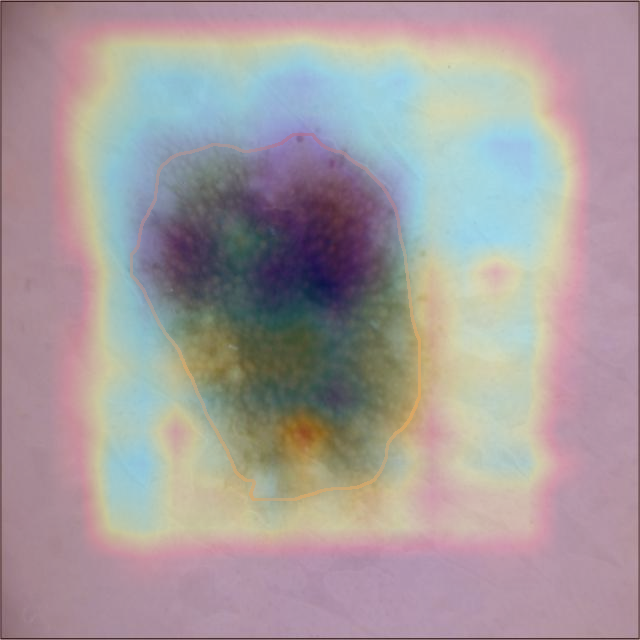

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
image_path = "/content/drive/MyDrive/NIDHI/datasets/skindetect_seg/train/images/"
dir_list = os.listdir("/content/drive/MyDrive/NIDHI/datasets/skindetect_seg/train/images")

for fil in dir_list:
    # print(fil)
    if dir_list.index(fil)%5 ==0:
      # print(dir_list.index(fil),fil)
      image_new = predict_heat(cv2.imread(image_path+fil))
      cv2_imshow(image_new)
      cv2.imwrite("/content/drive/MyDrive/result/segmentation/Without_egin/"+fil, image_new)
      break


JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[131.00000, 134.00000, 420.00000, 500.00000,   0.93504,   2.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


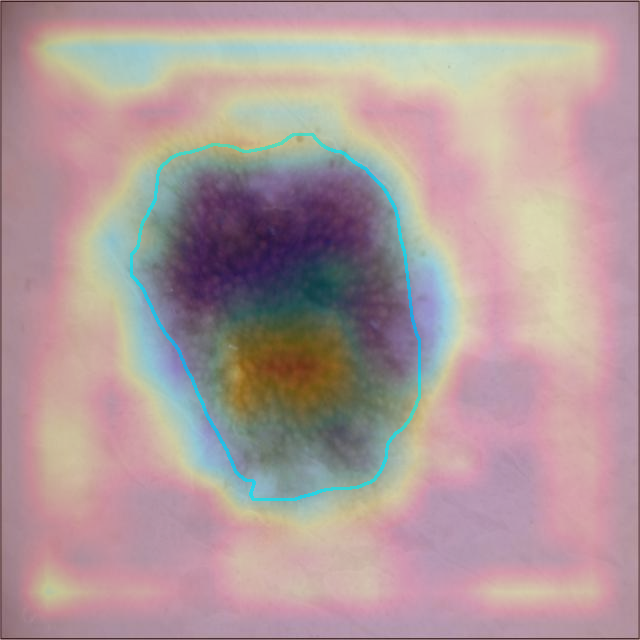

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[105.00000,  84.00000, 502.00000, 624.00000,   0.92708,   2.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


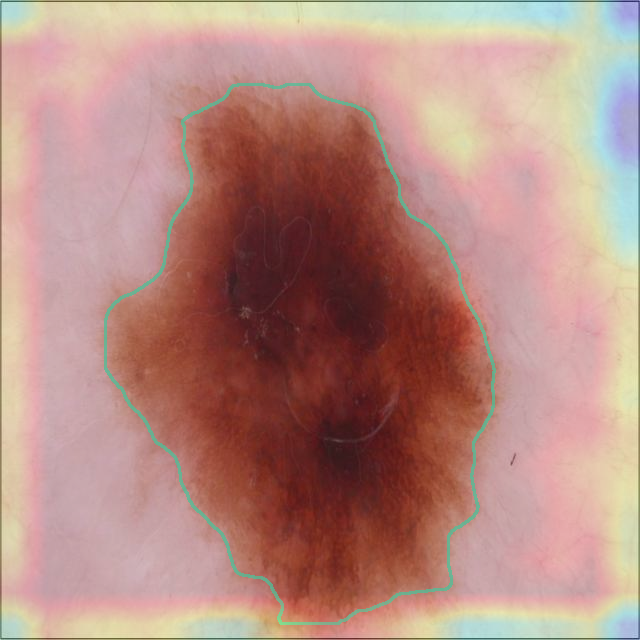

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[125.00000, 121.00000, 561.00000, 553.00000,   0.89285,   2.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


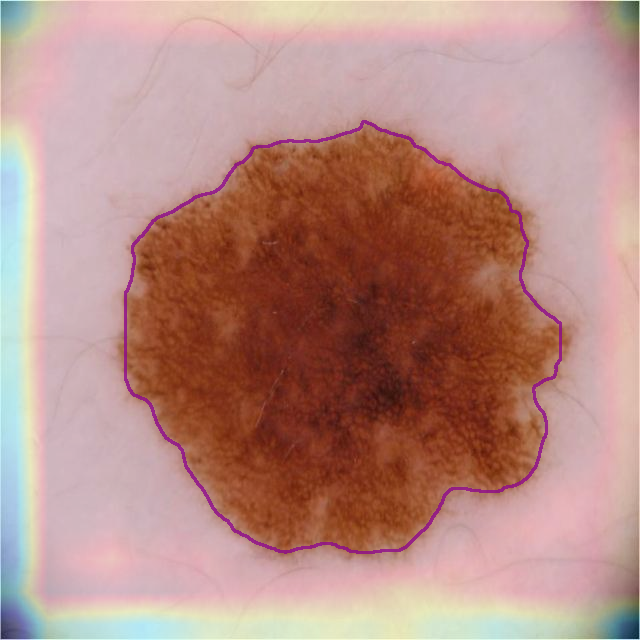

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[4.40000e+01, 3.80000e+01, 5.67000e+02, 6.23000e+02, 2.68320e-01, 2.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


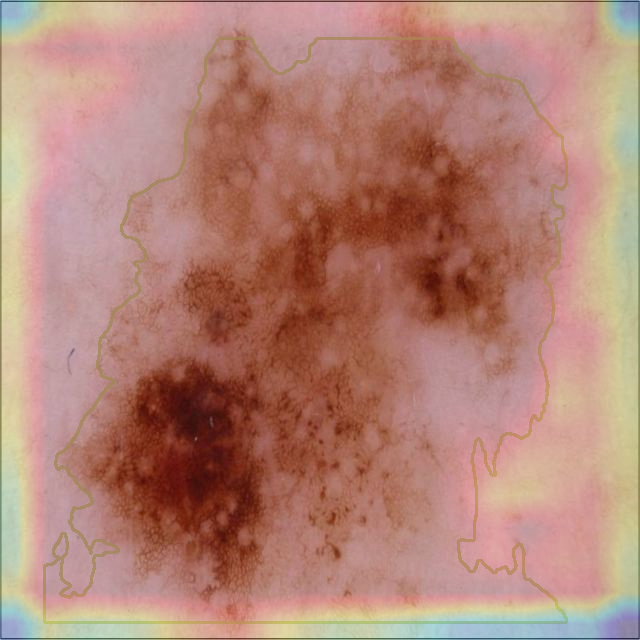

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([7, 6])
dtype: torch.float32
 + tensor([[2.54000e+02, 5.80000e+01, 3.01000e+02, 1.03000e+02, 6.57019e-01, 1.00000e+00],
        [7.90000e+01, 3.50000e+01, 5.91000e+02, 6.16000e+02, 5.41206e-01, 2.00000e+00],
        [1.04000e+02, 3.05000e+02, 1.34000e+02, 3.54000e+02, 5.14962e-01, 1.00000e+00],
        [3.24000e+02, 2.80000e+02, 3.44000e+02, 3.02000e+02, 3.68999e-01, 1.00000e+00],
        [1.90000e+02, 1.40000e+02, 2.06000e+02, 1.58000e+02, 3.45511e-01, 1.00000e+00],
        [2.31000e+02, 1.75000e+02, 2.44000e+02, 1.89000e+02, 3.03153e-01, 1.00000e+00],
        [4.15000e+02, 4.30000e+02, 4.54000e+02, 4.82000e+02, 2.70695e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([7, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],


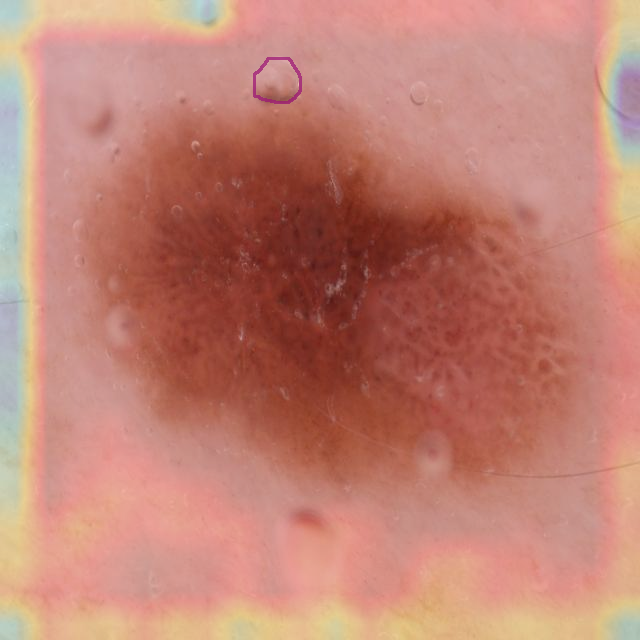

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[233.00000, 209.00000, 431.00000, 472.00000,   0.94684,   2.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


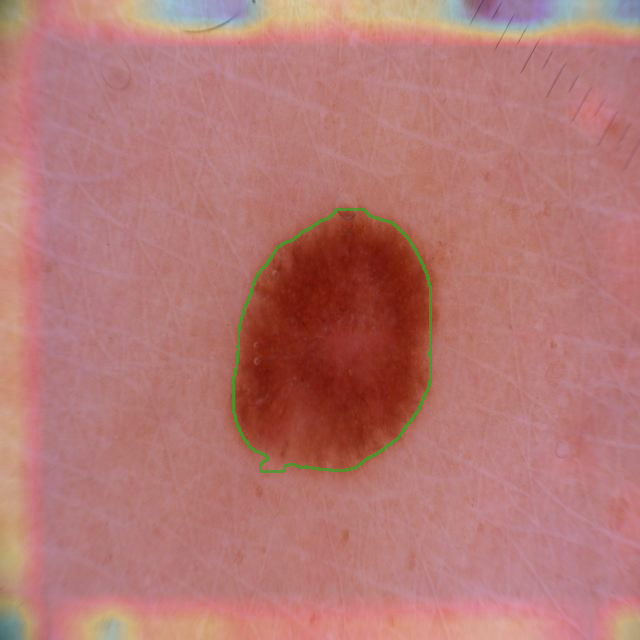

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 6])
dtype: torch.float32
 + tensor([[1.80000e+02, 1.36000e+02, 4.83000e+02, 5.39000e+02, 7.57667e-01, 2.00000e+00],
        [1.04000e+02, 2.41000e+02, 1.20000e+02, 2.63000e+02, 4.50076e-01, 1.00000e+00],
        [1.06000e+02, 2.42000e+02, 1.19000e+02, 2.60000e+02, 4.34234e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
        

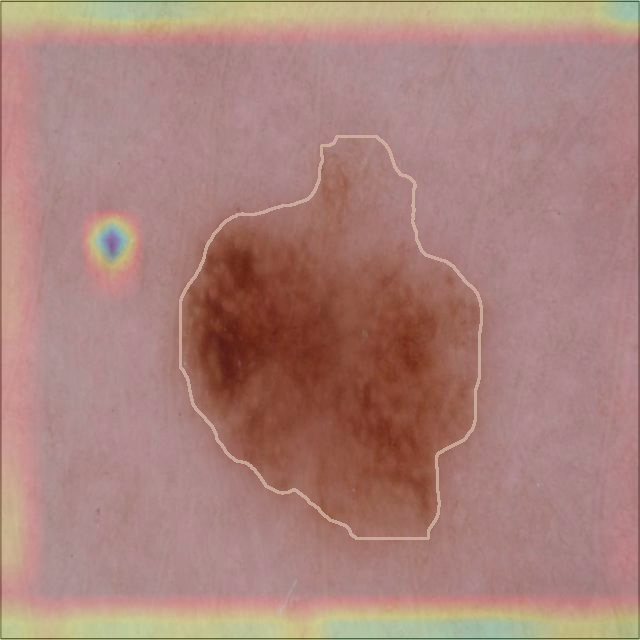

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[208.00000,  62.00000, 491.00000, 489.00000,   0.60192,   3.00000],
        [208.00000,  56.00000, 491.00000, 488.00000,   0.56503,   2.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  .

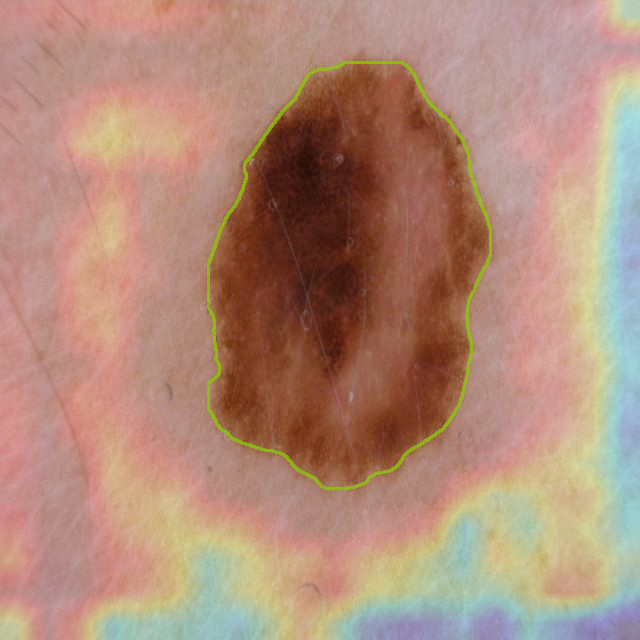

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([0, 6])
dtype: torch.float32
 + tensor([], device='cuda:0', size=(0, 6))]
MOMOM
<class 'AttributeError'> <ipython-input-10-9f2c6bf3b0b4> 14
'NoneType' object has no attribute 'segments'
MKFDMKD
<class 'cv2.error'> <ipython-input-13-27a4c543c45f> 14
OpenCV(4.8.0) /io/opencv/modules/core/src/arithm.cpp:647: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'



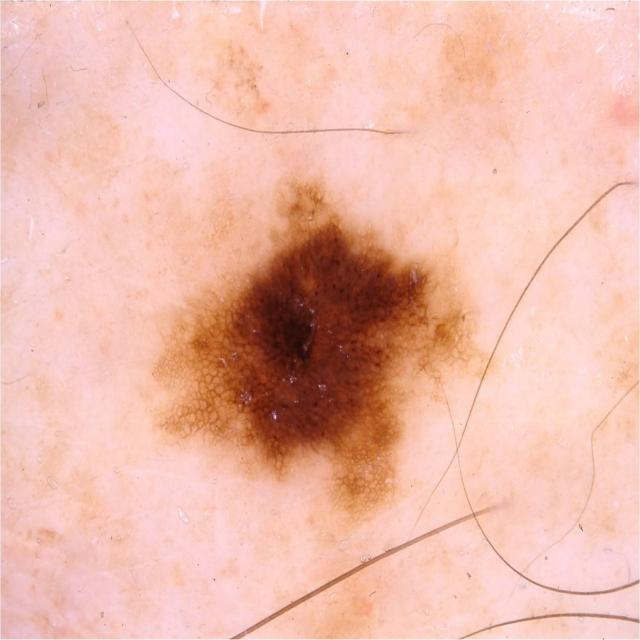

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([5, 6])
dtype: torch.float32
 + tensor([[8.60000e+01, 5.25000e+02, 1.13000e+02, 5.71000e+02, 8.21562e-01, 1.00000e+00],
        [1.63000e+02, 4.75000e+02, 1.93000e+02, 5.17000e+02, 7.90552e-01, 1.00000e+00],
        [6.60000e+01, 4.40000e+01, 1.10000e+02, 1.22000e+02, 3.88950e-01, 1.00000e+00],
        [1.98000e+02, 4.70000e+01, 2.24000e+02, 8.90000e+01, 3.31660e-01, 1.00000e+00],
        [2.90000e+02, 5.35000e+02, 3.06000e+02, 5.61000e+02, 2.99437e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([5, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]

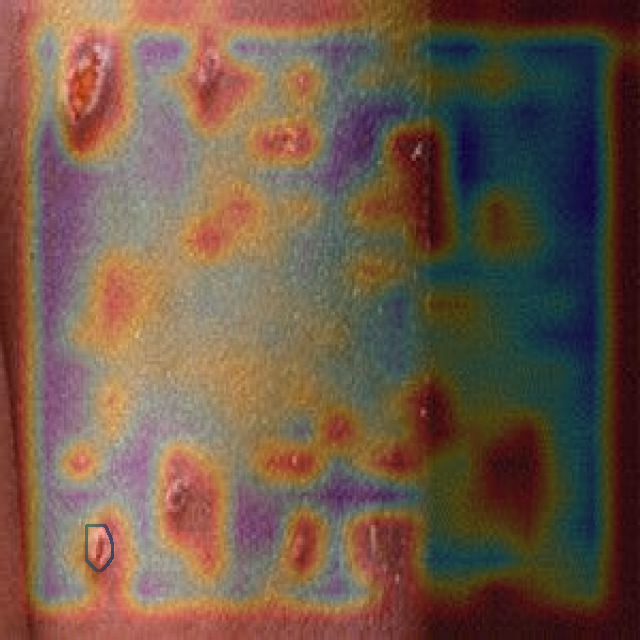

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([9, 6])
dtype: torch.float32
 + tensor([[2.13000e+02, 2.30000e+01, 2.86000e+02, 6.50000e+01, 7.98948e-01, 1.00000e+00],
        [2.04000e+02, 4.02000e+02, 2.56000e+02, 4.64000e+02, 7.50924e-01, 1.00000e+00],
        [4.14000e+02, 1.05000e+02, 4.84000e+02, 1.73000e+02, 6.36424e-01, 1.00000e+00],
        [2.89000e+02, 5.93000e+02, 3.53000e+02, 6.40000e+02, 6.13656e-01, 1.00000e+00],
        [3.10000e+02, 5.60000e+01, 3.86000e+02, 1.15000e+02, 4.85455e-01, 1.00000e+00],
        [3.45000e+02, 4.92000e+02, 5.21000e+02, 6.40000e+02, 4.49878e-01, 1.00000e+00],
        [3.90000e+02, 2.20000e+01, 4.55000e+02, 8.30000e+01, 4.14343e-01, 1.00000e+00],
        [3.66000e+02, 2.90000e+02, 4.30000e+02, 3.60000e+02, 3.84727e-01, 1.00000e+00],
        [3.44000e+02, 4.99000e+02, 4.23000e+02, 5.68000e+02, 2.99950e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <clas

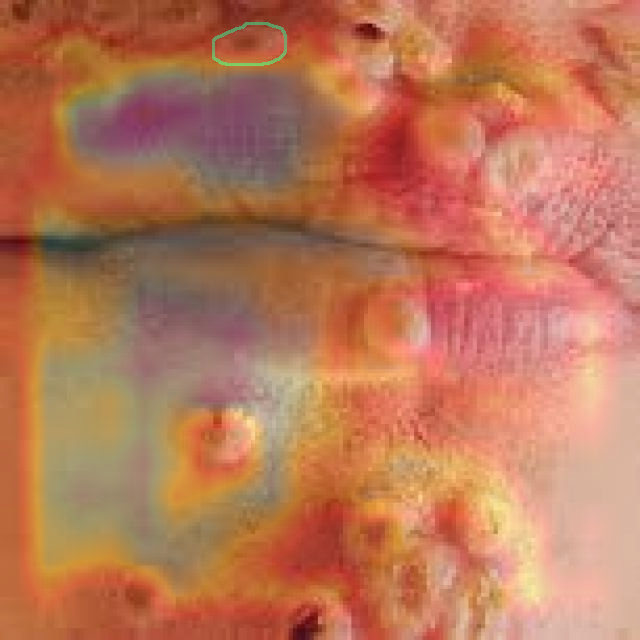

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[3.13000e+02, 2.62000e+02, 3.49000e+02, 2.99000e+02, 4.17917e-01, 1.00000e+00],
        [3.14000e+02, 2.65000e+02, 3.47000e+02, 2.97000e+02, 3.25479e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


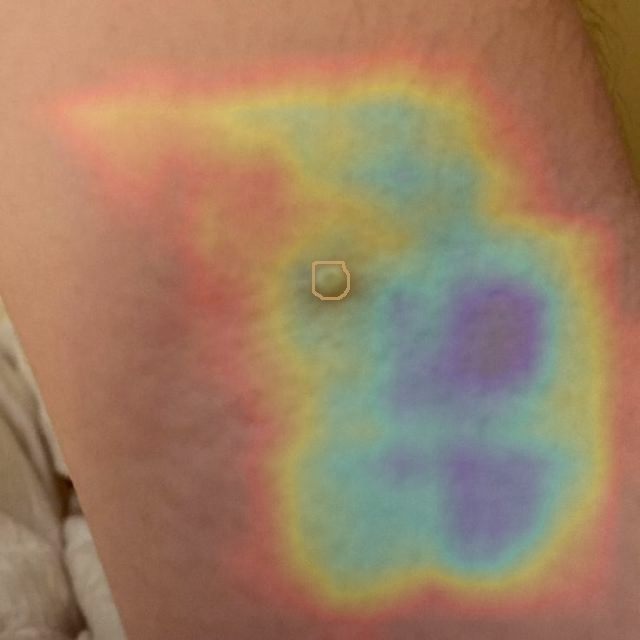

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[394.00000, 403.00000, 428.00000, 437.00000,   0.48298,   1.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


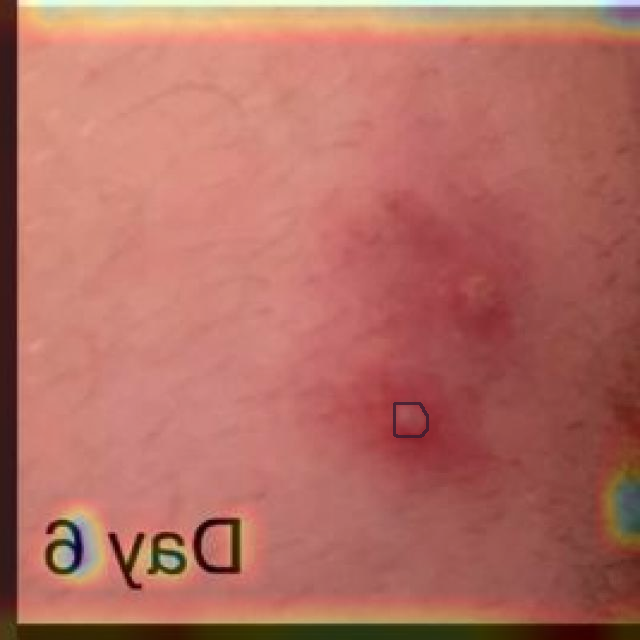

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[255.00000, 201.00000, 374.00000, 322.00000,   0.60506,   1.00000],
        [ 44.00000, 447.00000, 156.00000, 567.00000,   0.59079,   3.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  .

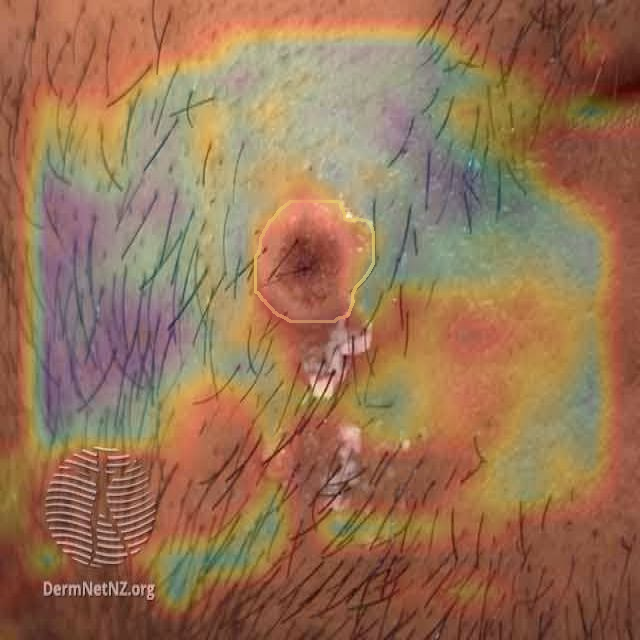

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([0, 6])
dtype: torch.float32
 + tensor([], device='cuda:0', size=(0, 6))]
MOMOM
<class 'AttributeError'> <ipython-input-10-9f2c6bf3b0b4> 14
'NoneType' object has no attribute 'segments'
MKFDMKD
<class 'cv2.error'> <ipython-input-13-27a4c543c45f> 14
OpenCV(4.8.0) /io/opencv/modules/core/src/arithm.cpp:647: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'



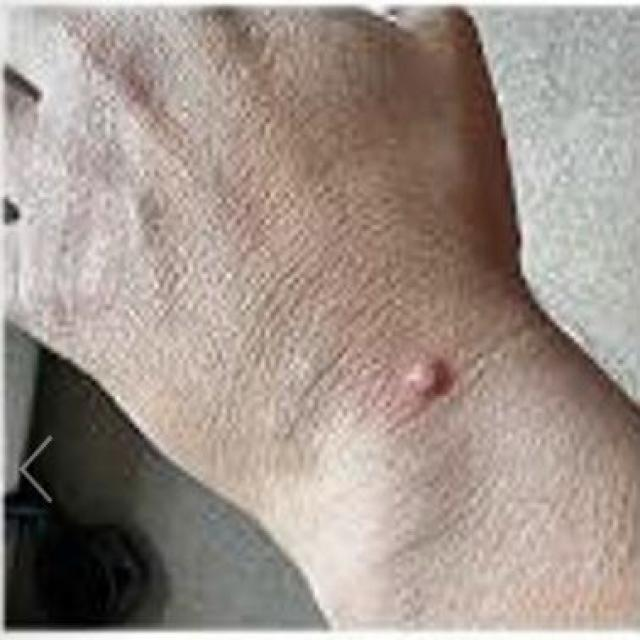

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 6])
dtype: torch.float32
 + tensor([[4.50000e+02, 6.90000e+01, 5.15000e+02, 1.57000e+02, 8.40853e-01, 1.00000e+00],
        [3.04000e+02, 3.67000e+02, 3.90000e+02, 5.02000e+02, 6.13272e-01, 1.00000e+00],
        [4.05000e+02, 5.15000e+02, 4.67000e+02, 6.40000e+02, 5.22362e-01, 1.00000e+00],
        [4.74000e+02, 1.57000e+02, 5.41000e+02, 3.06000e+02, 4.97810e-01, 1.00000e+00],
        [3.72000e+02, 2.26000e+02, 4.56000e+02, 3.81000e+02, 4.54370e-01, 1.00000e+00],
        [2.57000e+02, 1.86000e+02, 3.30000e+02, 3.25000e+02, 3.05998e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
      

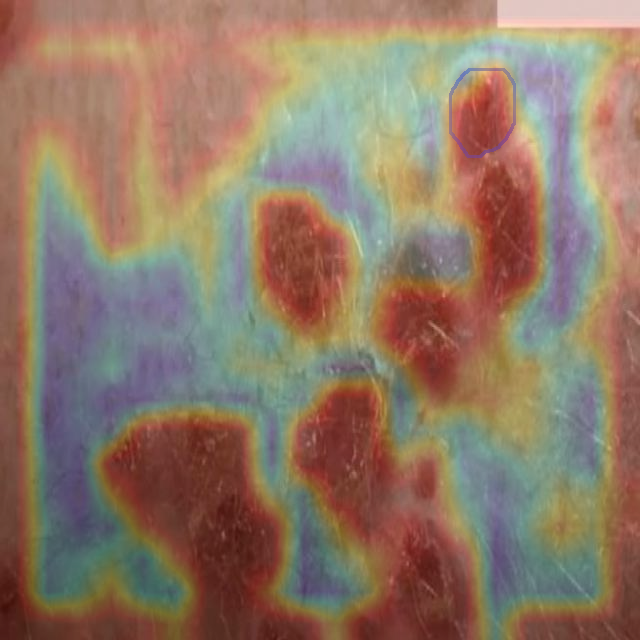

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[3.19000e+02, 2.68000e+02, 3.51000e+02, 3.38000e+02, 3.48683e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


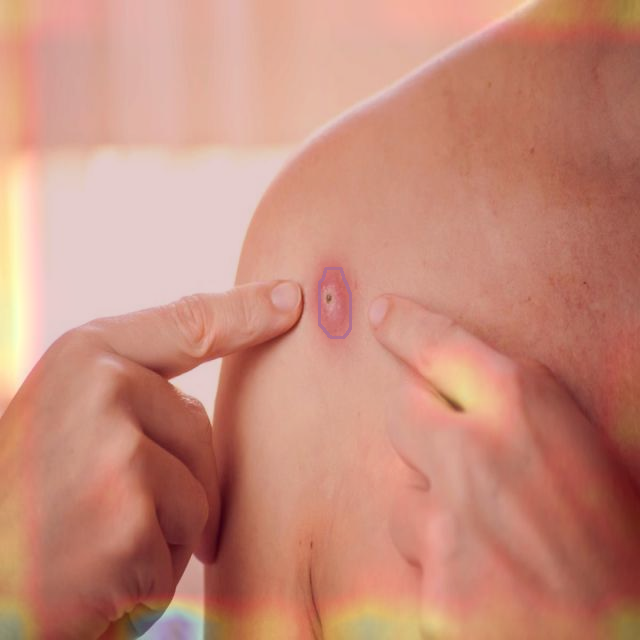

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 6])
dtype: torch.float32
 + tensor([[3.14000e+02, 3.11000e+02, 3.54000e+02, 3.49000e+02, 7.93395e-01, 1.00000e+00],
        [2.74000e+02, 3.31000e+02, 3.05000e+02, 3.69000e+02, 5.70233e-01, 1.00000e+00],
        [5.38000e+02, 2.80000e+02, 5.64000e+02, 3.05000e+02, 2.55158e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
        

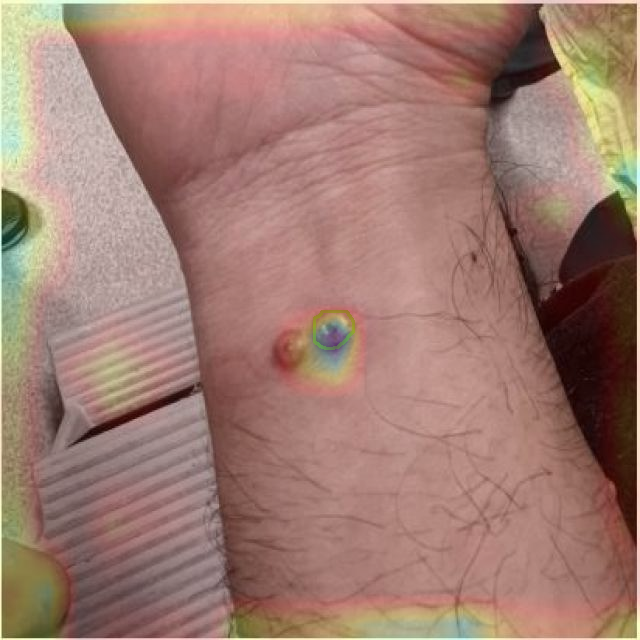

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([4, 6])
dtype: torch.float32
 + tensor([[3.14000e+02, 3.49000e+02, 3.38000e+02, 3.74000e+02, 8.63025e-01, 3.00000e+00],
        [2.43000e+02, 4.46000e+02, 4.66000e+02, 6.07000e+02, 5.00597e-01, 3.00000e+00],
        [2.58000e+02, 5.15000e+02, 3.70000e+02, 6.40000e+02, 3.42362e-01, 3.00000e+00],
        [2.43000e+02, 4.47000e+02, 4.02000e+02, 6.02000e+02, 2.70670e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([4, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
  

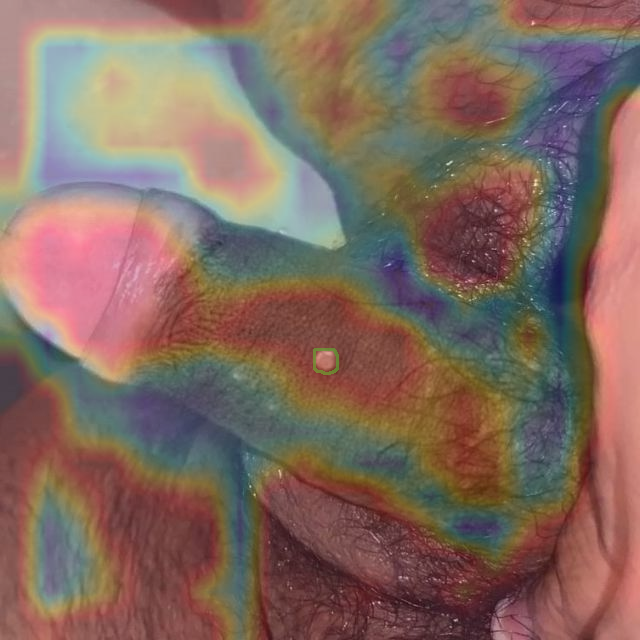

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[365.00000, 290.00000, 388.00000, 316.00000,   0.81788,   3.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


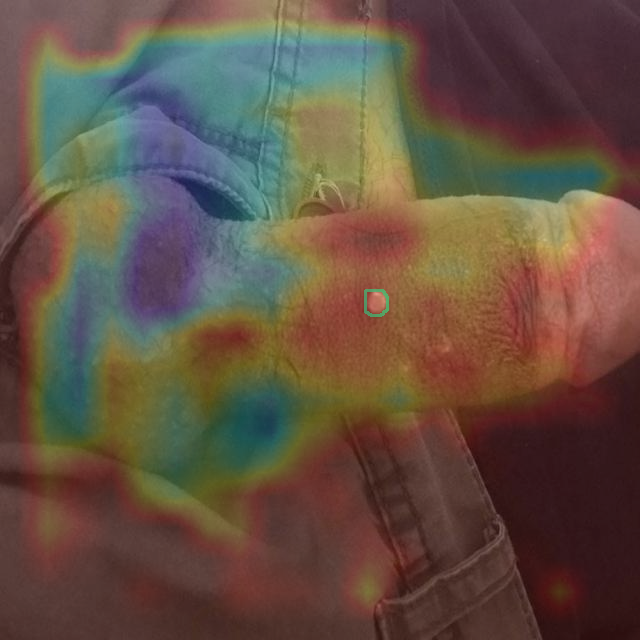

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 6])
dtype: torch.float32
 + tensor([[3.70000e+02, 3.69000e+02, 4.15000e+02, 4.03000e+02, 9.10800e-01, 3.00000e+00],
        [2.05000e+02, 2.79000e+02, 2.37000e+02, 2.99000e+02, 8.88816e-01, 3.00000e+00],
        [3.04000e+02, 2.49000e+02, 3.70000e+02, 2.86000e+02, 8.51633e-01, 3.00000e+00],
        [3.17000e+02, 3.39000e+02, 3.36000e+02, 3.52000e+02, 6.19389e-01, 3.00000e+00],
        [4.64000e+02, 4.13000e+02, 4.77000e+02, 4.29000e+02, 4.74202e-01, 3.00000e+00],
        [2.32000e+02, 3.36000e+02, 2.54000e+02, 3.54000e+02, 3.68518e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
      

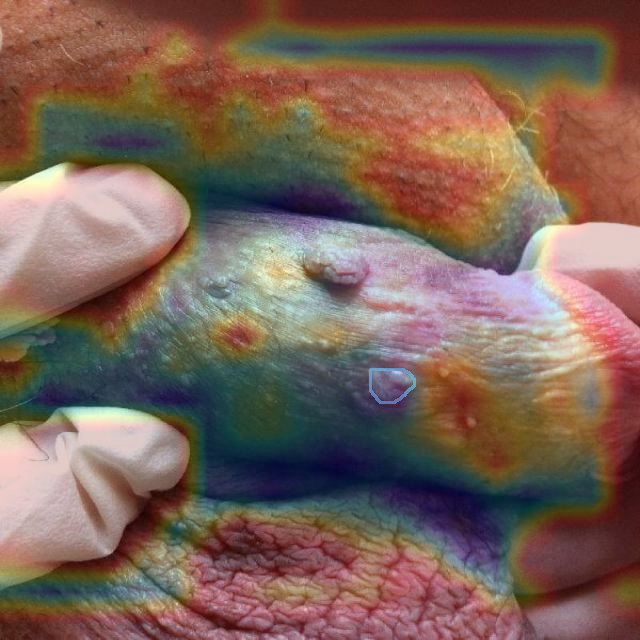

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 6])
dtype: torch.float32
 + tensor([[2.29000e+02, 1.50000e+02, 3.69000e+02, 4.89000e+02, 9.56847e-01, 3.00000e+00],
        [3.40000e+01, 3.51000e+02, 2.02000e+02, 6.39000e+02, 8.48948e-01, 3.00000e+00],
        [3.28000e+02, 6.00000e+00, 5.19000e+02, 5.32000e+02, 7.11744e-01, 3.00000e+00],
        [1.15000e+02, 0.00000e+00, 1.57000e+02, 4.00000e+01, 5.94646e-01, 1.00000e+00],
        [5.40000e+02, 1.00000e+00, 6.17000e+02, 1.56000e+02, 3.47933e-01, 3.00000e+00],
        [2.30000e+02, 3.69000e+02, 2.90000e+02, 4.88000e+02, 2.76178e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
      

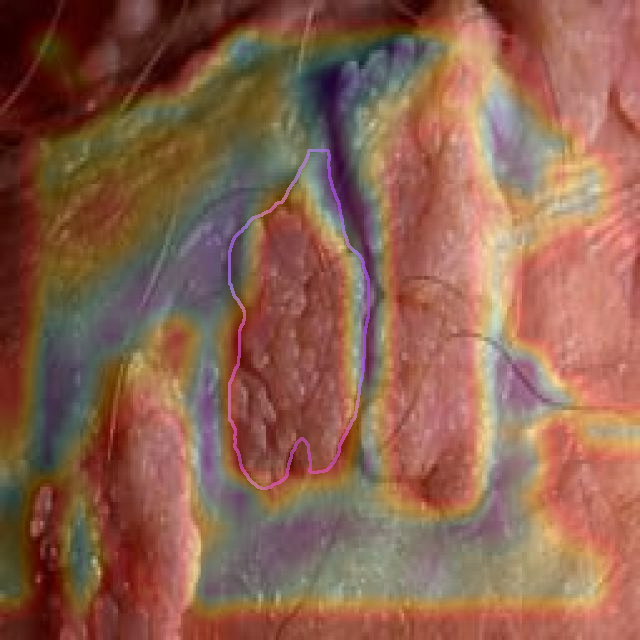

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([0, 6])
dtype: torch.float32
 + tensor([], device='cuda:0', size=(0, 6))]
MOMOM
<class 'AttributeError'> <ipython-input-10-9f2c6bf3b0b4> 14
'NoneType' object has no attribute 'segments'
MKFDMKD
<class 'cv2.error'> <ipython-input-13-27a4c543c45f> 14
OpenCV(4.8.0) /io/opencv/modules/core/src/arithm.cpp:647: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'



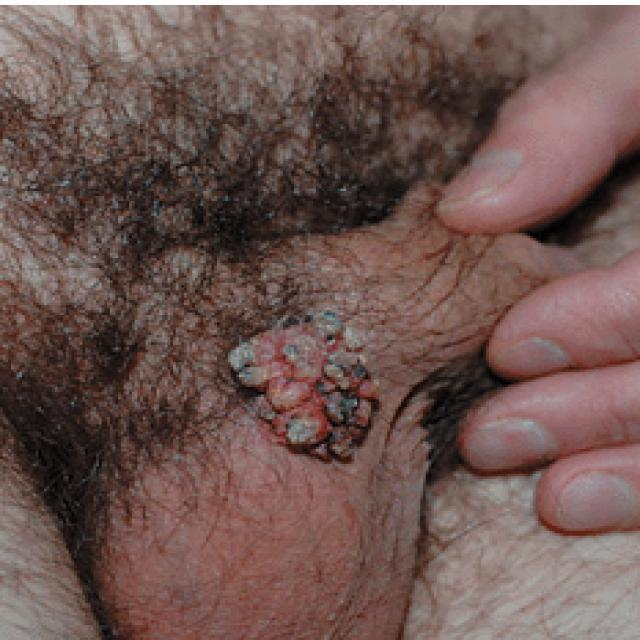

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([8, 6])
dtype: torch.float32
 + tensor([[2.51000e+02, 3.07000e+02, 3.15000e+02, 3.71000e+02, 8.83301e-01, 3.00000e+00],
        [2.73000e+02, 2.18000e+02, 3.25000e+02, 2.74000e+02, 8.78993e-01, 3.00000e+00],
        [3.76000e+02, 3.55000e+02, 4.07000e+02, 3.88000e+02, 6.96495e-01, 3.00000e+00],
        [3.83000e+02, 4.40000e+02, 4.36000e+02, 5.01000e+02, 6.47490e-01, 3.00000e+00],
        [2.33000e+02, 1.58000e+02, 3.18000e+02, 2.25000e+02, 6.45987e-01, 3.00000e+00],
        [3.49000e+02, 5.13000e+02, 3.88000e+02, 5.62000e+02, 6.24732e-01, 3.00000e+00],
        [3.24000e+02, 3.54000e+02, 4.18000e+02, 4.53000e+02, 5.97557e-01, 3.00000e+00],
        [3.25000e+02, 3.83000e+02, 4.16000e+02, 4.53000e+02, 3.97755e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: tor

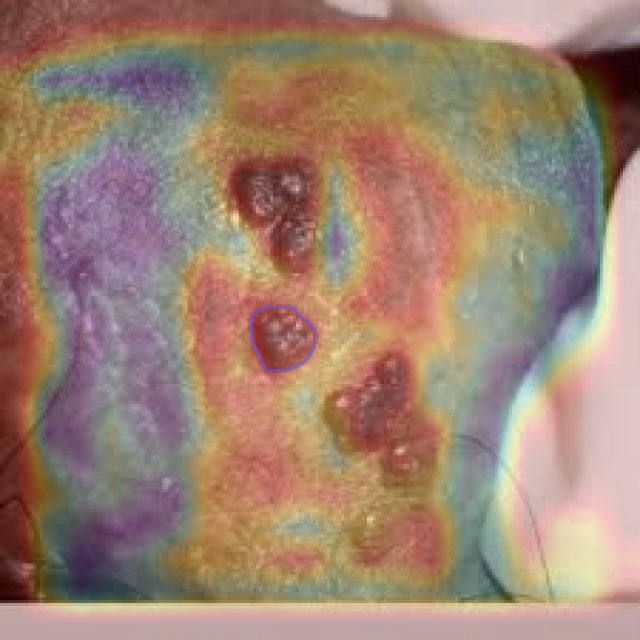

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([7, 6])
dtype: torch.float32
 + tensor([[1.00000e+02, 1.01000e+02, 3.13000e+02, 3.71000e+02, 9.84871e-01, 3.00000e+00],
        [1.58000e+02, 3.42000e+02, 2.56000e+02, 4.77000e+02, 9.84290e-01, 3.00000e+00],
        [3.27000e+02, 9.10000e+01, 4.13000e+02, 2.66000e+02, 9.82306e-01, 3.00000e+00],
        [2.45000e+02, 2.68000e+02, 3.63000e+02, 5.04000e+02, 9.62664e-01, 3.00000e+00],
        [3.46000e+02, 2.97000e+02, 4.40000e+02, 3.98000e+02, 8.35305e-01, 3.00000e+00],
        [3.94000e+02, 5.39000e+02, 4.76000e+02, 6.29000e+02, 6.65612e-01, 3.00000e+00],
        [4.39000e+02, 2.49000e+02, 5.44000e+02, 4.38000e+02, 3.21252e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([7, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],


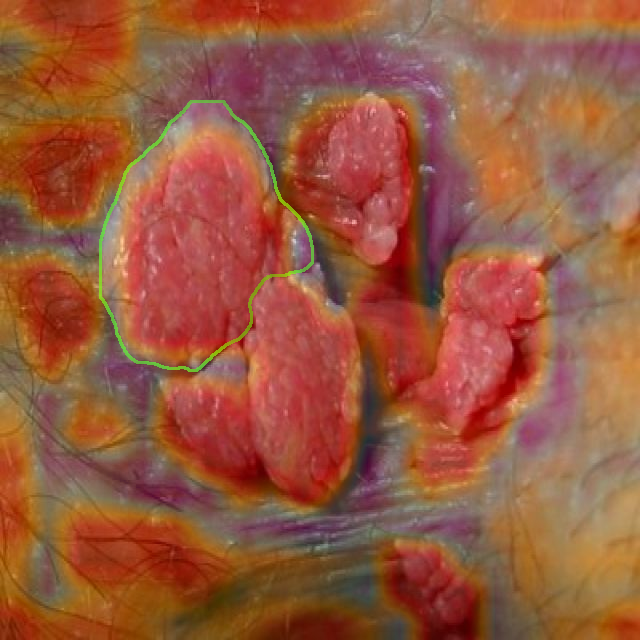

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[231.00000, 161.00000, 443.00000, 484.00000,   0.96214,   0.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


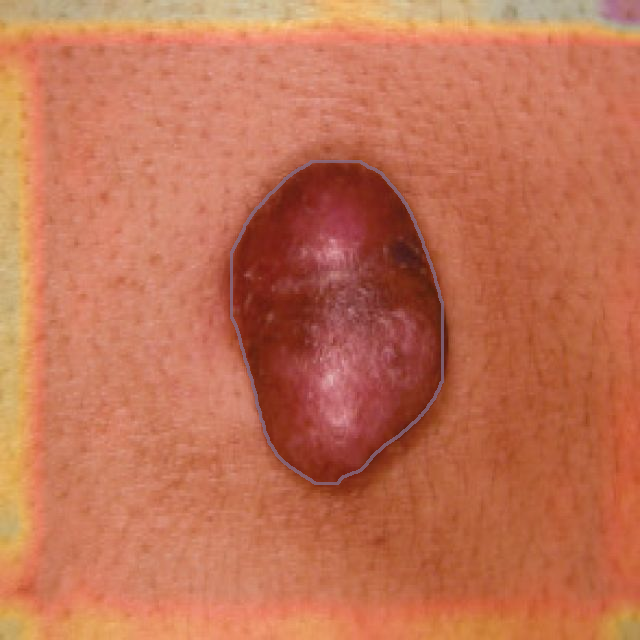

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[1.32000e+02, 1.42000e+02, 4.62000e+02, 6.35000e+02, 6.62695e-01, 0.00000e+00],
        [1.14000e+02, 6.03000e+02, 1.70000e+02, 6.39000e+02, 3.01428e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


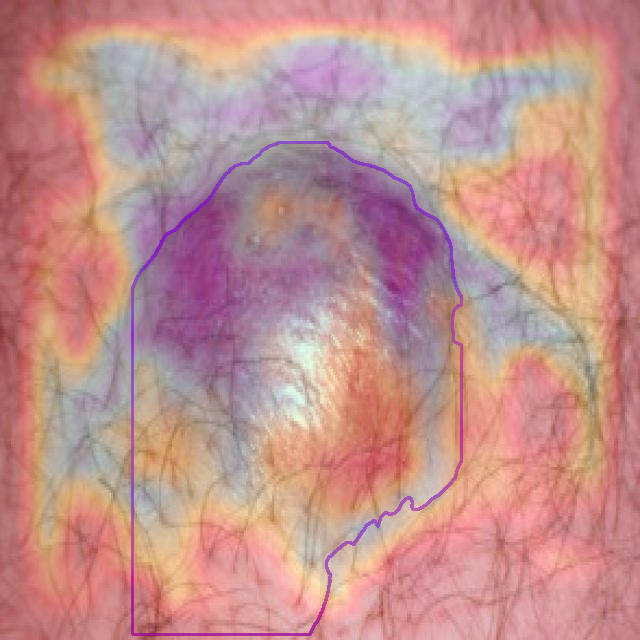

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 6])
dtype: torch.float32
 + tensor([[2.95000e+02, 1.86000e+02, 4.43000e+02, 3.60000e+02, 7.44201e-01, 0.00000e+00],
        [1.08000e+02, 5.84000e+02, 1.26000e+02, 6.08000e+02, 3.15647e-01, 1.00000e+00],
        [2.93000e+02, 6.22000e+02, 3.11000e+02, 6.40000e+02, 2.93306e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
        

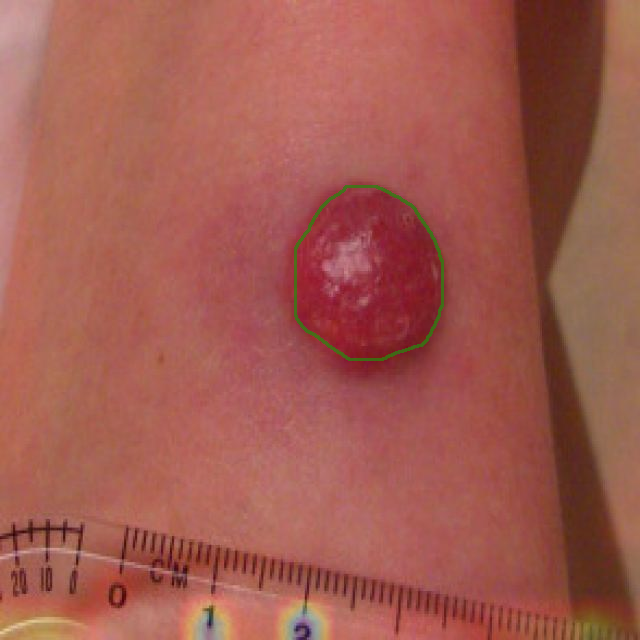

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[202.00000, 259.00000, 406.00000, 491.00000,   0.94670,   0.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


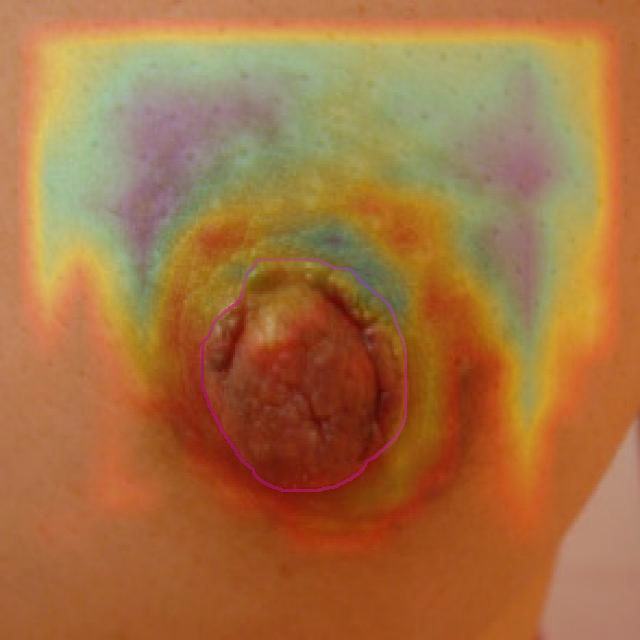

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[2.47000e+02, 1.39000e+02, 4.31000e+02, 4.07000e+02, 2.93769e-01, 0.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


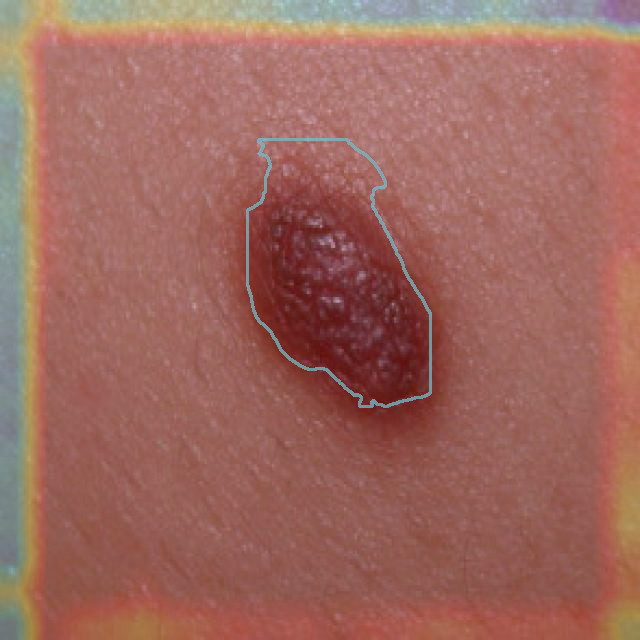

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[2.68000e+02, 2.55000e+02, 3.36000e+02, 4.21000e+02, 9.12862e-01, 3.00000e+00],
        [2.67000e+02, 3.33000e+02, 3.30000e+02, 4.20000e+02, 2.66020e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


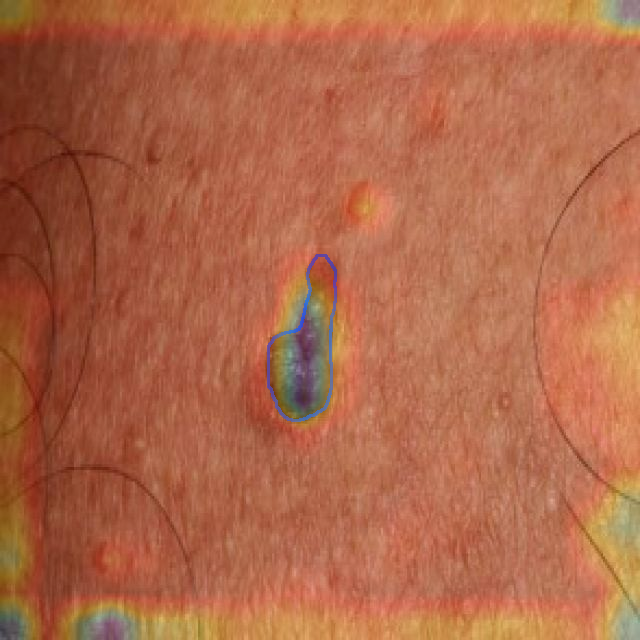

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[2.89000e+02, 2.18000e+02, 3.82000e+02, 4.15000e+02, 8.74954e-01, 3.00000e+00],
        [1.01000e+02, 3.15000e+02, 1.43000e+02, 3.93000e+02, 2.63147e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


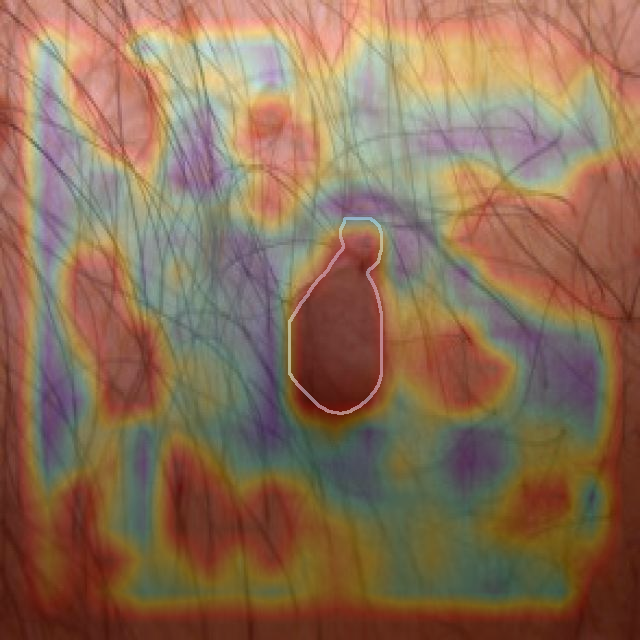

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([0, 6])
dtype: torch.float32
 + tensor([], device='cuda:0', size=(0, 6))]
MOMOM
<class 'AttributeError'> <ipython-input-10-9f2c6bf3b0b4> 14
'NoneType' object has no attribute 'segments'
MKFDMKD
<class 'cv2.error'> <ipython-input-13-27a4c543c45f> 14
OpenCV(4.8.0) /io/opencv/modules/core/src/arithm.cpp:647: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'



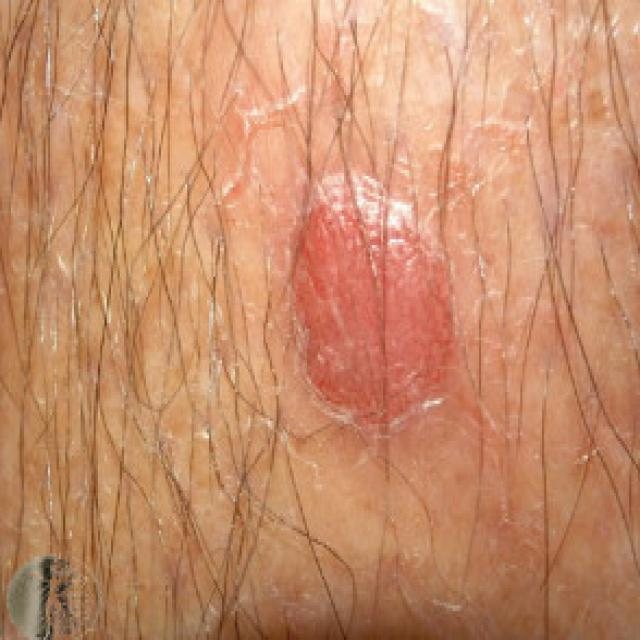

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[230.00000, 235.00000, 304.00000, 336.00000,   0.96421,   3.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


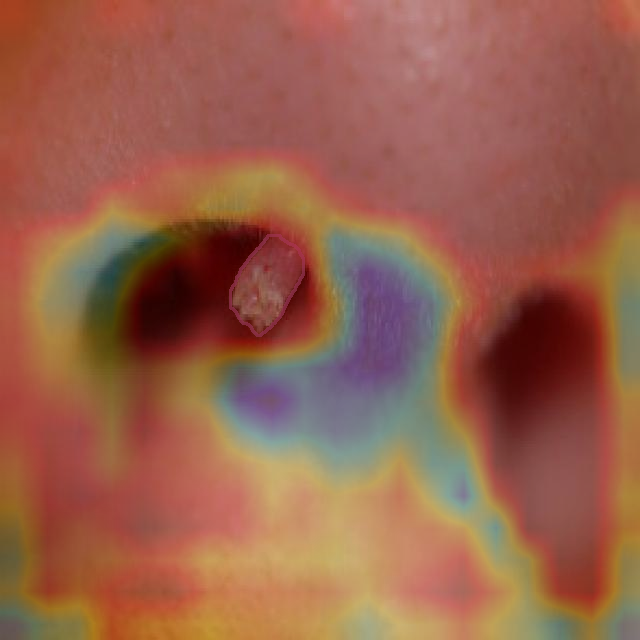

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[1.79000e+02, 1.94000e+02, 3.05000e+02, 3.58000e+02, 3.07859e-01, 3.00000e+00],
        [1.79000e+02, 1.95000e+02, 3.05000e+02, 3.58000e+02, 3.00852e-01, 0.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


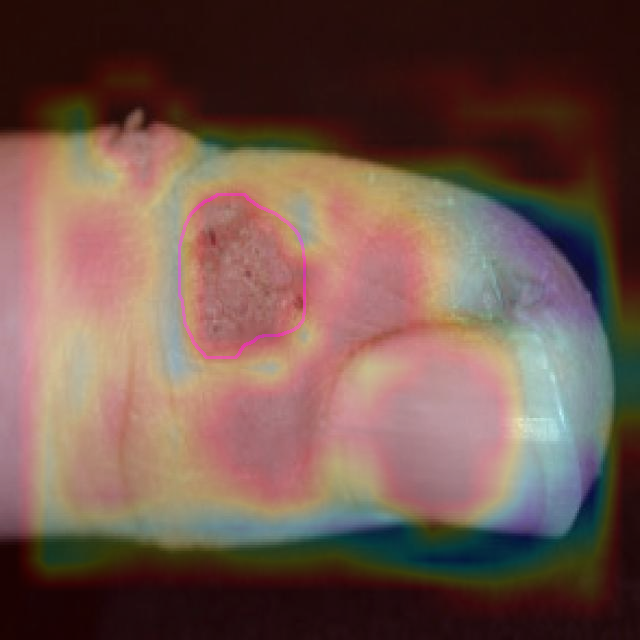

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 6])
dtype: torch.float32
 + tensor([[2.03000e+02, 1.15000e+02, 4.33000e+02, 4.43000e+02, 9.93191e-01, 3.00000e+00],
        [4.13000e+02, 6.50000e+01, 5.06000e+02, 1.57000e+02, 5.85912e-01, 3.00000e+00],
        [4.96000e+02, 4.30000e+01, 5.41000e+02, 7.30000e+01, 3.62351e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([3, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
        

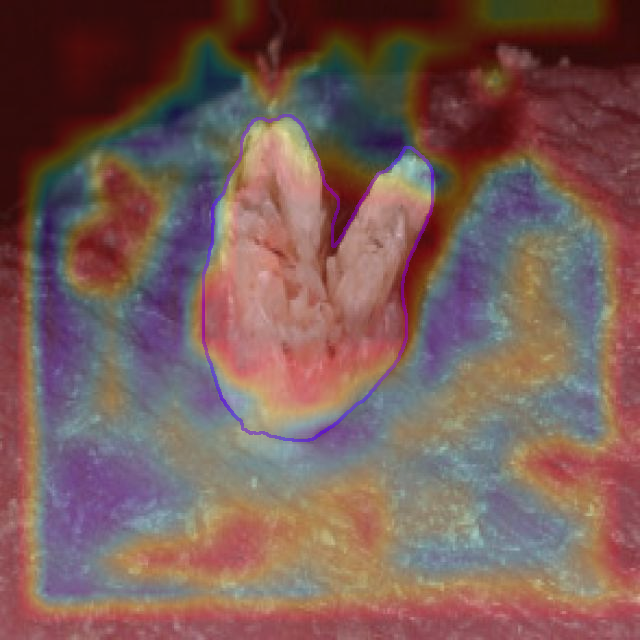

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[2.46000e+02, 1.42000e+02, 3.48000e+02, 2.96000e+02, 8.66998e-01, 3.00000e+00],
        [3.82000e+02, 5.74000e+02, 4.56000e+02, 6.40000e+02, 2.83771e-01, 1.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


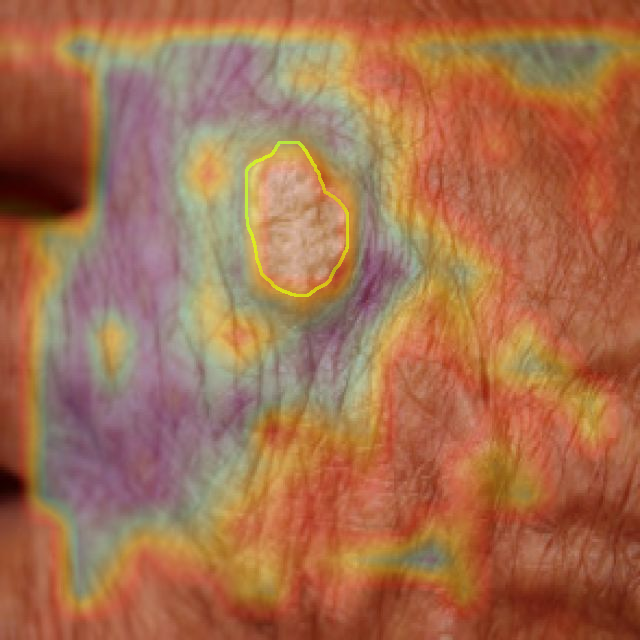

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 6])
dtype: torch.float32
 + tensor([[1.71000e+02, 1.21000e+02, 3.48000e+02, 3.88000e+02, 9.95833e-01, 3.00000e+00],
        [1.41000e+02, 5.15000e+02, 1.61000e+02, 5.42000e+02, 3.90039e-01, 3.00000e+00],
        [5.15000e+02, 5.56000e+02, 5.99000e+02, 6.40000e+02, 2.77530e-01, 3.00000e+00],
        [9.70000e+01, 4.18000e+02, 1.39000e+02, 4.71000e+02, 2.70214e-01, 1.00000e+00],
        [5.96000e+02, 5.71000e+02, 6.39000e+02, 6.40000e+02, 2.62058e-01, 3.00000e+00],
        [9.90000e+01, 4.18000e+02, 1.41000e+02, 4.70000e+02, 2.53656e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([6, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
      

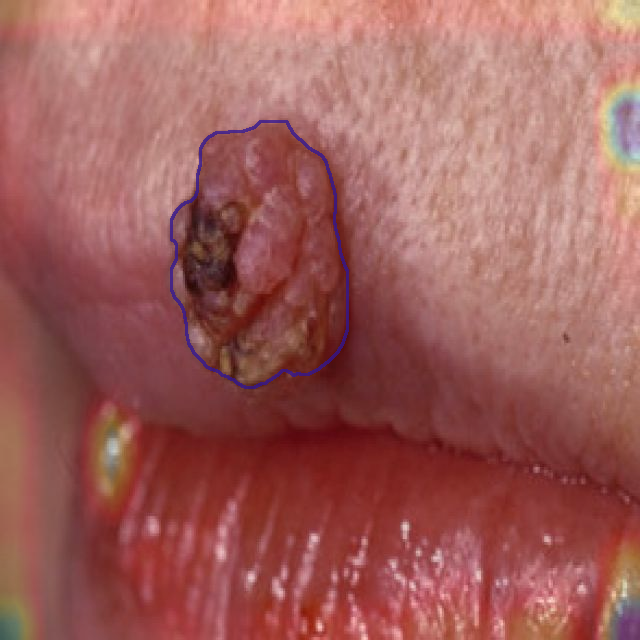

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 6])
dtype: torch.float32
 + tensor([[2.05000e+02, 1.56000e+02, 4.19000e+02, 4.36000e+02, 5.56148e-01, 0.00000e+00],
        [5.30000e+02, 3.65000e+02, 6.19000e+02, 4.28000e+02, 4.45881e-01, 3.00000e+00]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([2, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],


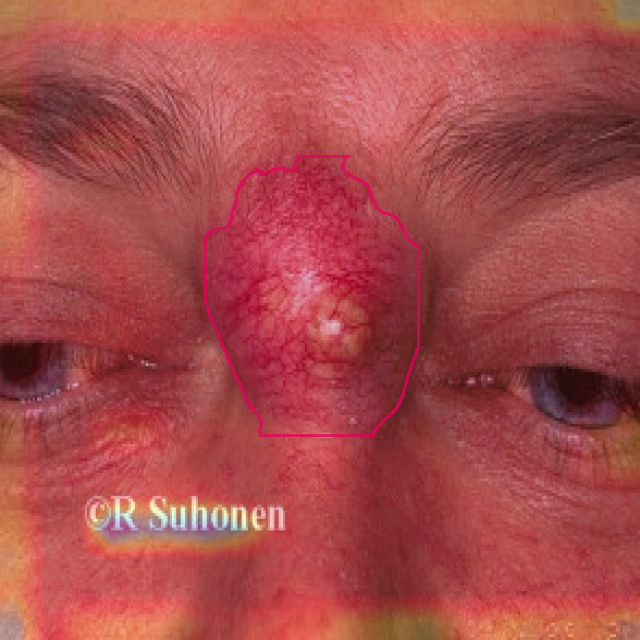

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 6])
dtype: torch.float32
 + tensor([[282.00000, 327.00000, 330.00000, 406.00000,   0.79881,   3.00000]], device='cuda:0')Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Masks'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([1, 640, 640])
dtype: torch.float32
 + tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0')]


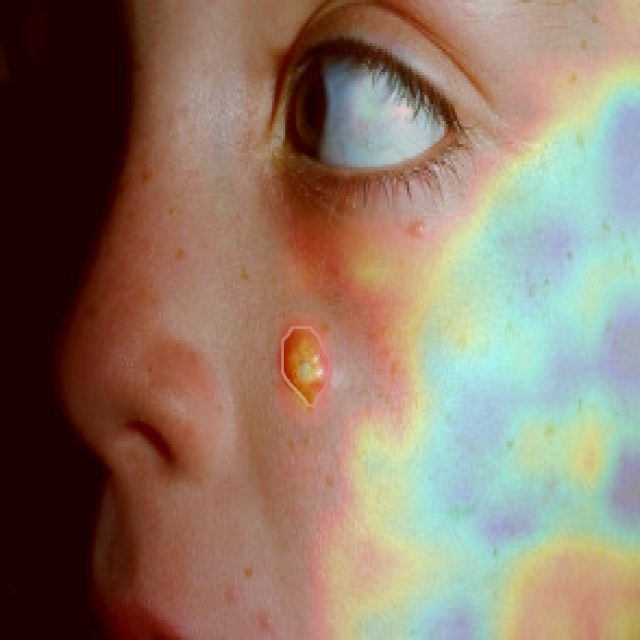

JJJJJJJJJJJJJJJJJ
[Ultralytics YOLO <class 'ultralytics.yolo.engine.results.Boxes'> masks
type: <class 'torch.Tensor'>
shape: torch.Size([0, 6])
dtype: torch.float32
 + tensor([], device='cuda:0', size=(0, 6))]
MOMOM
<class 'AttributeError'> <ipython-input-10-9f2c6bf3b0b4> 14
'NoneType' object has no attribute 'segments'
MKFDMKD
<class 'cv2.error'> <ipython-input-13-27a4c543c45f> 14
OpenCV(4.8.0) /io/opencv/modules/core/src/arithm.cpp:647: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'



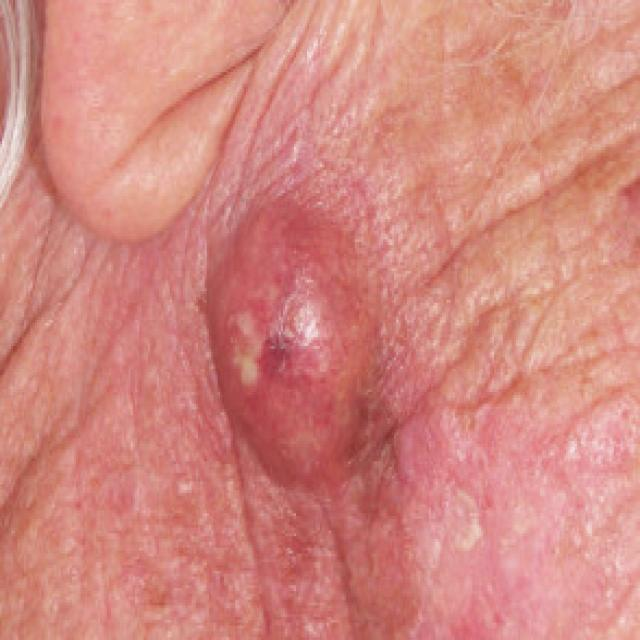

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
image_path = "/content/drive/MyDrive/NIDHI/datasets/skindetect_seg/train/images/"
dir_list = os.listdir("/content/drive/MyDrive/NIDHI/datasets/skindetect_seg/train/images")

for fil in dir_list:
    # print(fil)
    if dir_list.index(fil)%5 ==0:
      # print(dir_list.index(fil),fil)
      image_new = predict_heat(cv2.imread(image_path+fil))
      cv2_imshow(image_new)
      cv2.imwrite("/content/drive/MyDrive/result/segmentation/With_egin/"+fil, image_new)
      # break
